In [1]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import ydata_profiling  # pandas_profiling
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from collections import Counter
from sklearn.cluster import KMeans
from kneed import KneeLocator
from pylab import *

In [2]:
data = pd.read_csv("D:\programming\Machine Learning/Customer_Data.csv")
data

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [3]:
df = data.replace('C1','', regex=True)
df["CUST_ID"] = df["CUST_ID"].astype("int")
df

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,2,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,3,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,4,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,5,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,9186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,9187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,9188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,9189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [4]:
df.shape

(8950, 18)

In [5]:
df.describe(include="all")

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,4600.040670,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2651.305875,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,2307.250000,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,4598.500000,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,6899.750000,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,9190.000000,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


<div style=" font-size:14px; line_height:160%">
With a general look at the values in the datasat, we can guess that the values of the PURCHASES column are equall to ONEOFF PURCHASES + INSTALLMENT PURCHASES values.<br/>
Let's see if our guess is True...

In [6]:
df.columns[2] == df.columns[3] + df.columns[4]

False

<div style=" font-size:14px; line_height:160%">
They are not equall.
Let's see how many samples are different:

In [7]:
compare = pd.DataFrame()
compare["purchases"] = df["PURCHASES"]
compare["oneoff+installment"] = df["ONEOFF_PURCHASES"] + df["INSTALLMENTS_PURCHASES"]

m = compare["purchases"] == compare["oneoff+installment"]
Counter(m)

Counter({True: 8458, False: 492})

<div style=" font-size:14px; line_height:160%">
As it can be seen, there are 492 samples in which PURCHASES column values are not equall to ONEOFF PURCHASES + INSTALLMENT PURCHASES.

<div style=" font-size:14px; line_height:160%">
Let's try to plot these samples:

In [8]:
compare["difference"] = compare["purchases"] - compare["oneoff+installment"]

compare

,purchases,oneoff+installment,difference
0,95.40,95.40,0.0
1,0.00,0.00,0.0
2,773.17,773.17,0.0
3,1499.00,1499.00,0.0
4,16.00,16.00,0.0
...,...,...,...
8945,291.12,291.12,0.0
8946,300.00,300.00,0.0
8947,144.40,144.40,0.0
8948,0.00,0.00,0.0


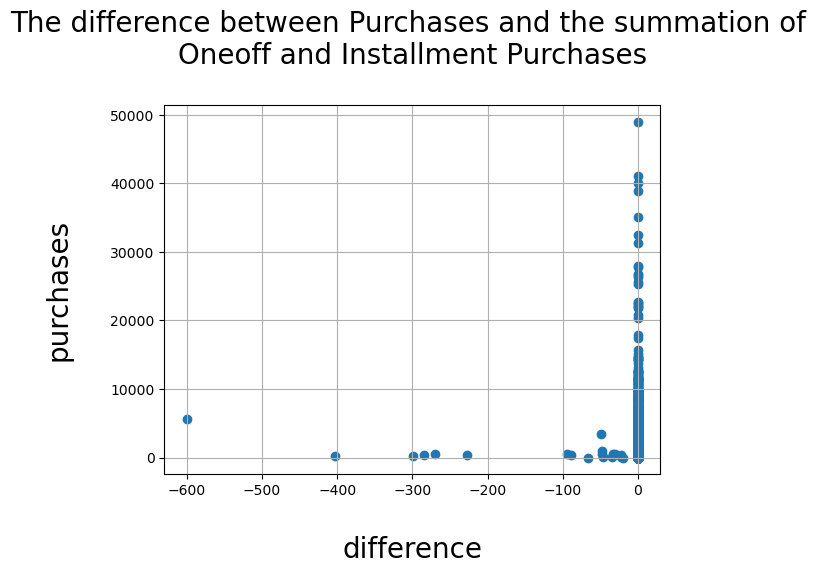

In [9]:
plt.scatter(compare.difference, compare.purchases)
plt.title("The difference between Purchases and the summation of \nOneoff and Installment Purchases\n", fontsize=20)
plt.xlabel("\ndifference", fontsize=20)
plt.ylabel("purchases\n", fontsize=20)
plt.grid()
plt.show()

In [10]:
compare[compare["difference"]<-1e-10].sort_values(by="difference")

,purchases,oneoff+installment,difference
6857,5629.41,6229.41,-600.00
5231,205.06,607.76,-402.70
5967,279.76,578.55,-298.79
6803,339.11,624.06,-284.95
8834,510.00,780.00,-270.00
6790,426.25,653.55,-227.30
5846,486.27,580.20,-93.93
510,400.41,489.39,-88.98
5737,0.00,66.95,-66.95
908,3393.25,3442.25,-49.00


<div style=" font-size:14px; line_height:160%">
There are 19 samples in which there are differences between PURCHASES column values and the summation of the two columns ONEOFF_PURCHASES and INSTALLMENT_PURCHASES.

<div style=" font-size:14px; line_height:160%">
I think it would be better if we delete them from the dataset.

In [11]:
df.drop(index=compare[compare["difference"]<-1e-10].index, inplace=True)
df.reset_index(drop=True, inplace=True)

In [12]:
df.shape

(8931, 18)

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8931 entries, 0 to 8930
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8931 non-null   int32  
 1   BALANCE                           8931 non-null   float64
 2   BALANCE_FREQUENCY                 8931 non-null   float64
 3   PURCHASES                         8931 non-null   float64
 4   ONEOFF_PURCHASES                  8931 non-null   float64
 5   INSTALLMENTS_PURCHASES            8931 non-null   float64
 6   CASH_ADVANCE                      8931 non-null   float64
 7   PURCHASES_FREQUENCY               8931 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8931 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8931 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8931 non-null   float64
 11  CASH_ADVANCE_TRX                  8931 non-null   int64  
 12  PURCHA

<div style=" font-size:14px; line_height:160%">
It can be seen that there are some missing values in the dataset.<br/>
Let's check them:

In [14]:
# df.isnull().any()
df.columns[df.isnull().any()].tolist()

['CREDIT_LIMIT', 'MINIMUM_PAYMENTS']

<div style=" font-size:14px; line_height:160%">
There are missing values in two columns. CREDIT_LIMIT and MINIMUM_PAYMENTS.<br/>
In the following cell we can find out how many rows are having missing values:

In [15]:
df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

<div style=" font-size:14px; line_height:160%">
There are 314 missing values.
One in CREDIT_LIMIT and 313 in MINIMUM_PAYMENTS.
Let's fill theme with the mean values of the related column.

In [16]:
df["MINIMUM_PAYMENTS"].fillna(np.mean(df["MINIMUM_PAYMENTS"]), inplace=True)
df["CREDIT_LIMIT"].fillna(np.mean(df["CREDIT_LIMIT"]), inplace=True)

In [17]:
df.duplicated().sum()

0

<div style=" font-size:14px; line_height:160%">
There is no duplicated rows in the dataframe.

<div style=" font-size:14px; line_height:160%">
We don't need the "CUST_ID" column for the clustering process

In [18]:
df.drop("CUST_ID", axis=1, inplace=True)

<div style=" font-size:14px; line_height:160%">
Using pandas profiling to have a quick look at the features:

In [19]:
ydata_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

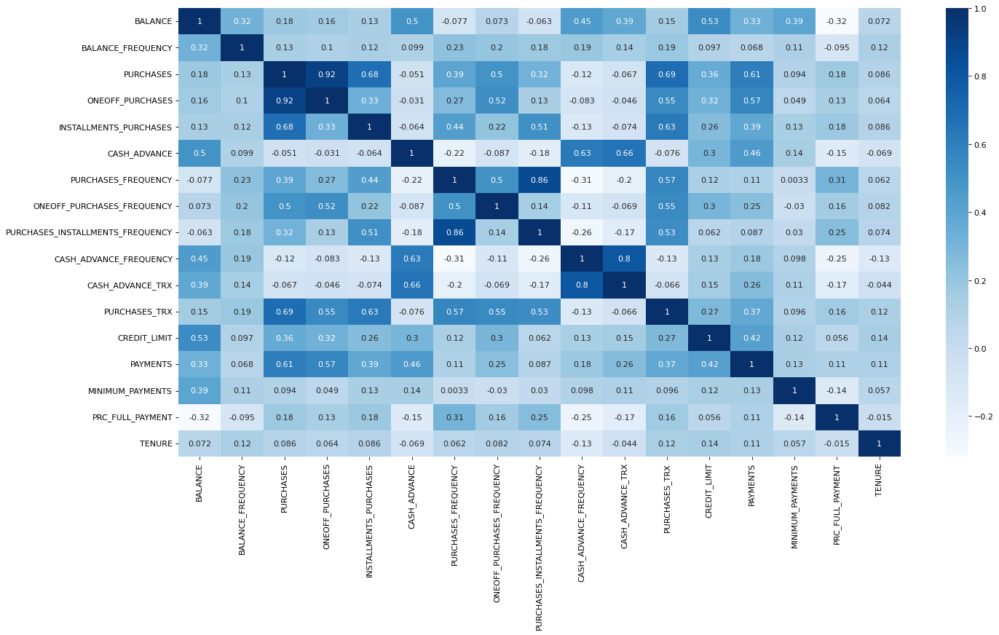

In [20]:
plt.figure(figsize=(20,10), dpi=80)
sns.heatmap(df.corr(), annot=True, cmap=plt.cm.Blues)
plt.show()

<div style=" font-size:14px; line_height:160%">
We have a high correlation between the two features ONEOFF_PURCHASES and PURCHASES but this issue does not have a big impact on the final resul<br/>
On the other hand, because we want to compare ONEOFF_PURCHASES with other features, we do not remove it.

<div style=" font-size:18px; line_height:160%">
Finding outliers:

In [21]:
def scatter_plots(df_name, x_ax_name, y_ax_name):
    scatter_name = f"{y_ax_name}-{x_ax_name}"
    fig_output_name = scatter_name
    plt.title(f"{x_ax_name} - {y_ax_name}\n")
    scatter_name = plt.scatter(df_name[x_ax_name], df_name[y_ax_name])
    scatter_name.axes.tick_params(gridOn=True, size=12, labelsize=10)
    plt.xlabel(f"\n{x_ax_name}", fontsize=20)
    plt.ylabel(f"{y_ax_name}\n", fontsize=20)
    plt.xticks(fontsize=15, rotation=60)
    plt.yticks(fontsize=15)


In [22]:
def scatter_subplots(df):
    
    for j in range(len(df.columns)):
        print(f"\nPlotting {df.columns[j]} with other columns:\n")
        i=1
        while i < len(df.columns):
            if j+i==len(df.columns):
                break
            plt.figure(figsize=(20,8), dpi=80)
            for k in range(3):
                plt.subplot(1, 3, k+1)                    
                scatter_plots(df, df.columns[j], df.columns[j+i])
                plt.title(f'"{df.columns[j]} - {df.columns[j+i]}"', fontsize=20)            
                i += 1
                if j+i==len(df.columns):
                    break

            plt.suptitle("Plotting Each Features vs Other Features", size = 30, fontweight = "bold")
            plt.tight_layout()
            plt.show()


Plotting BALANCE with other columns:



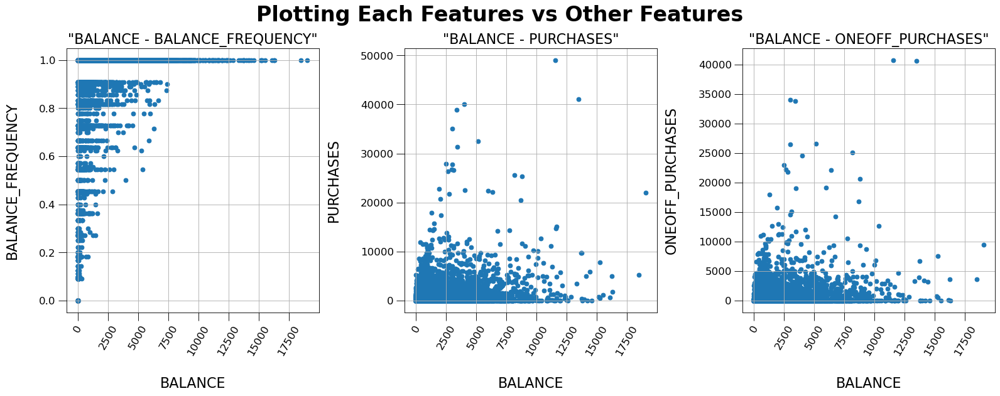

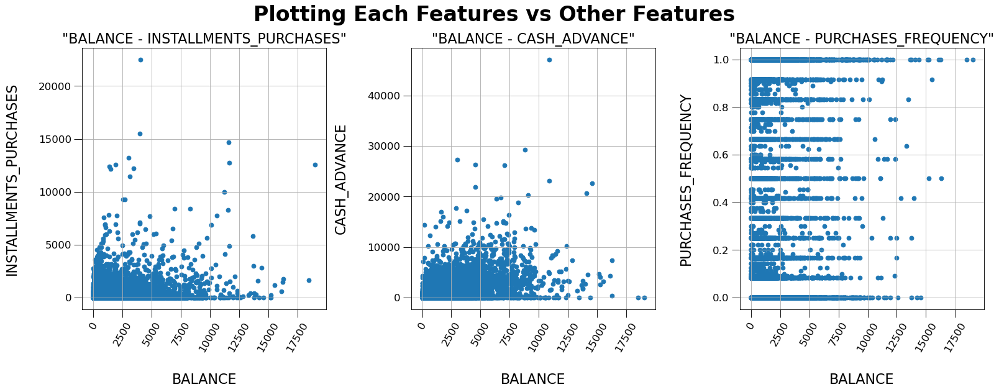

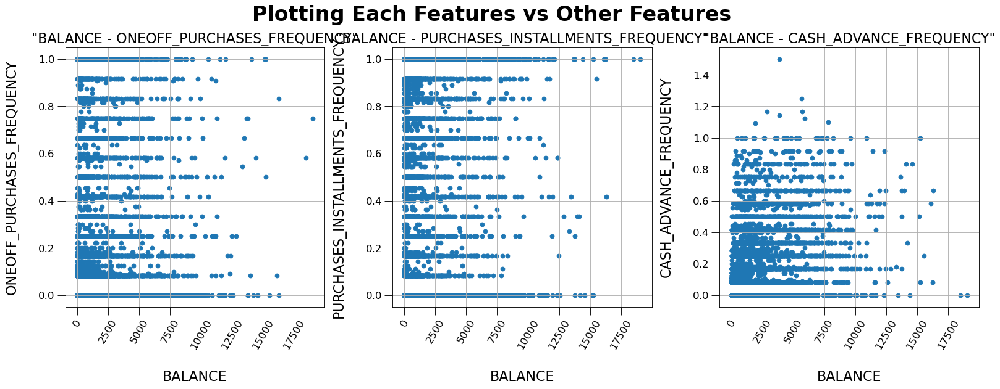

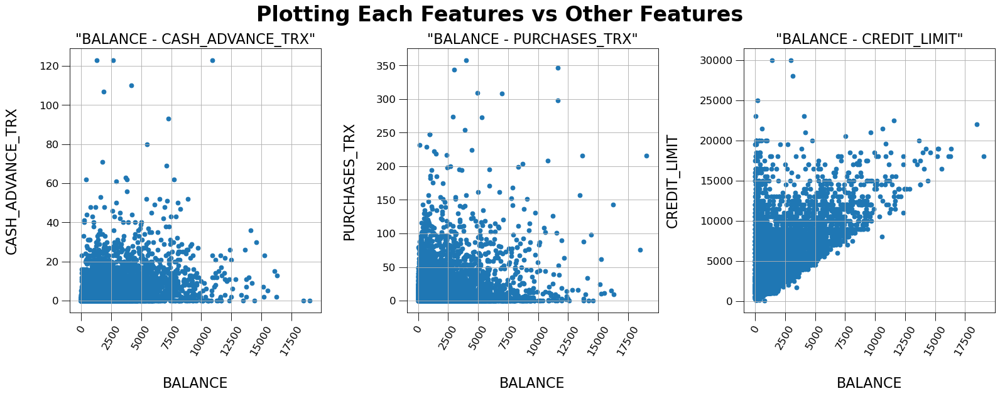

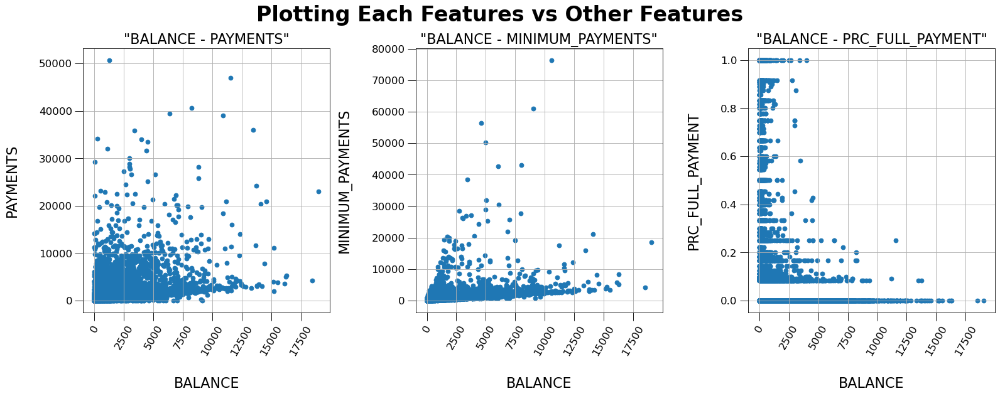

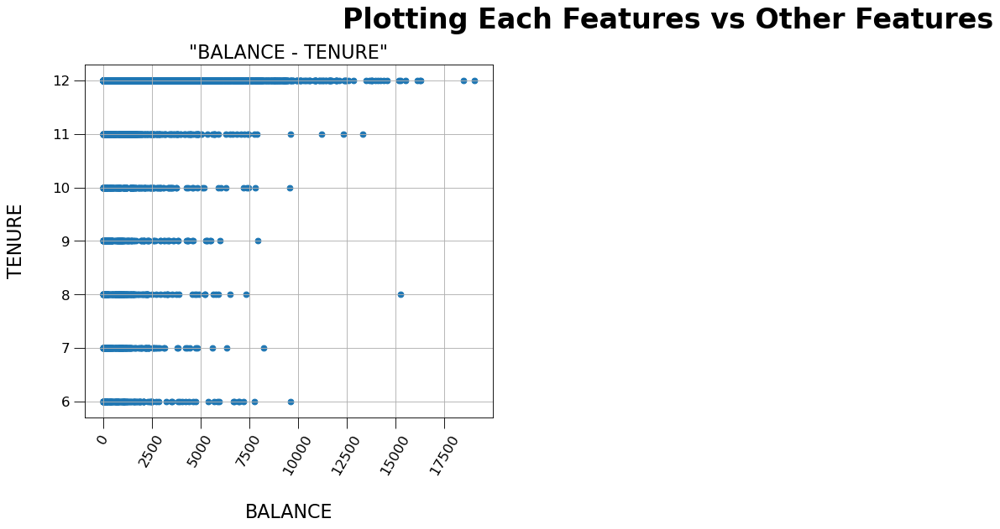


Plotting BALANCE_FREQUENCY with other columns:



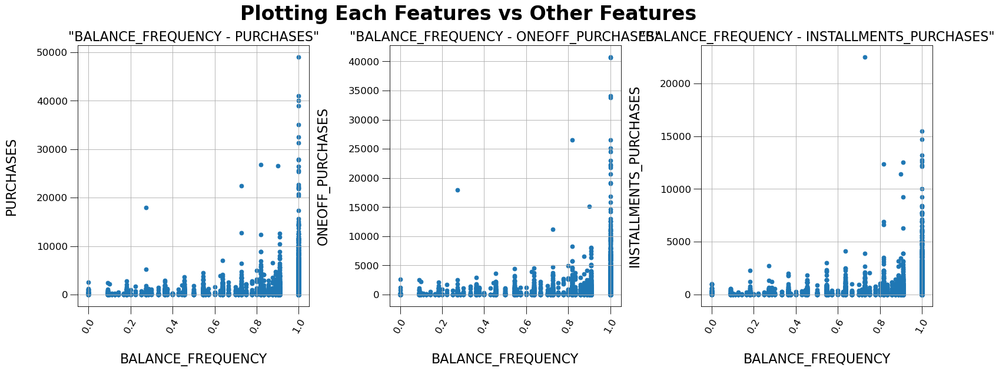

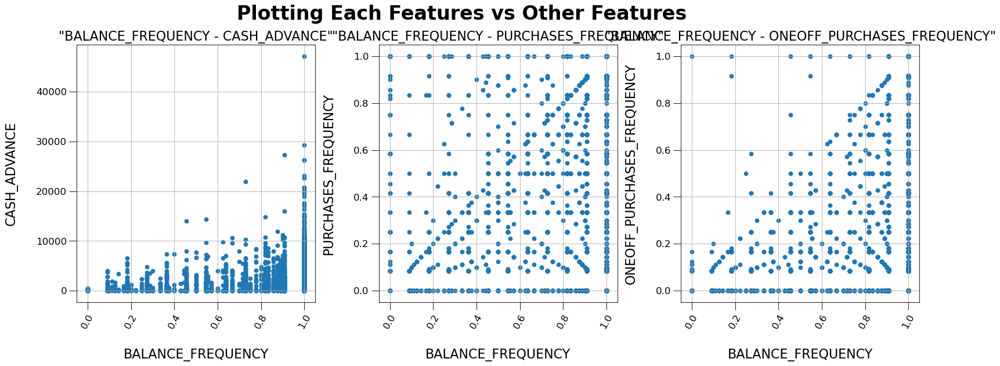

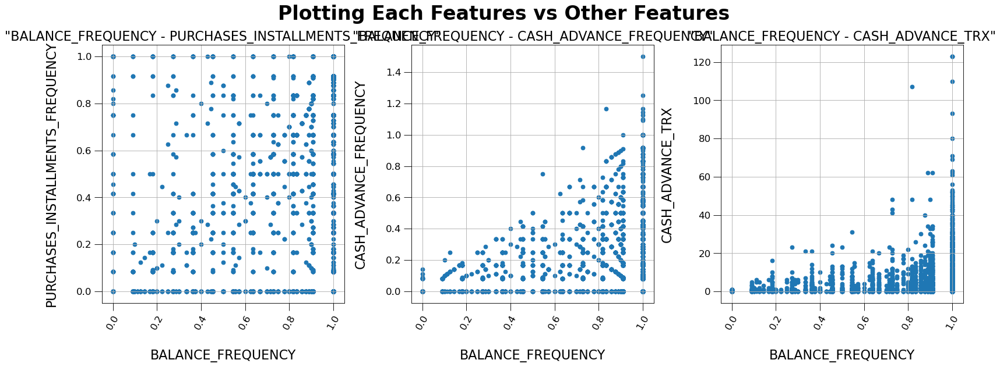

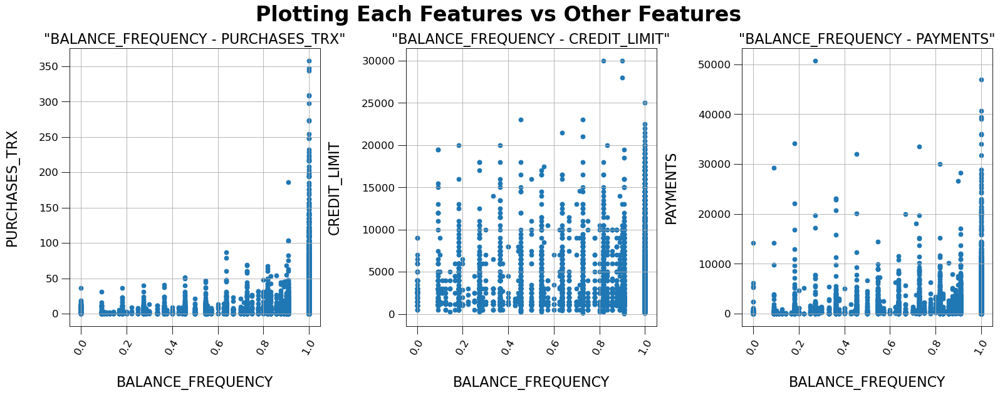

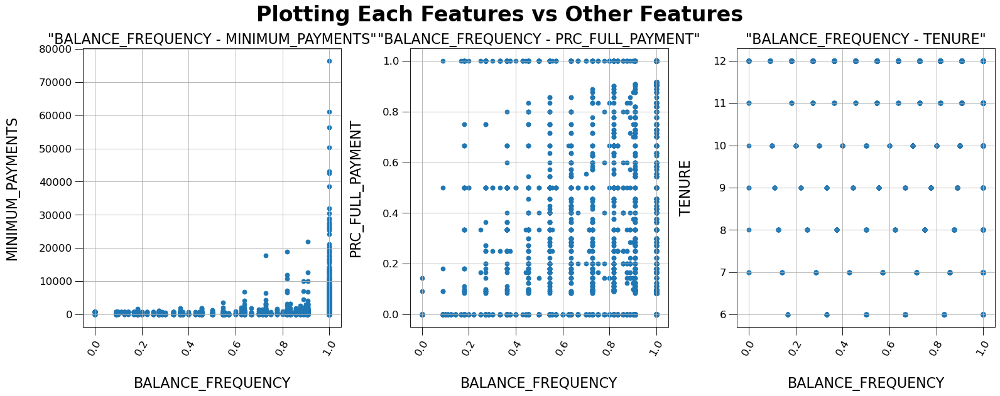


Plotting PURCHASES with other columns:



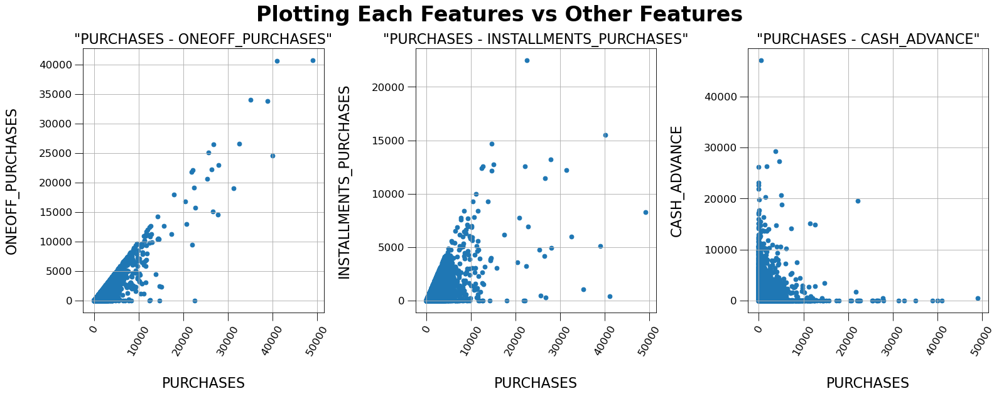

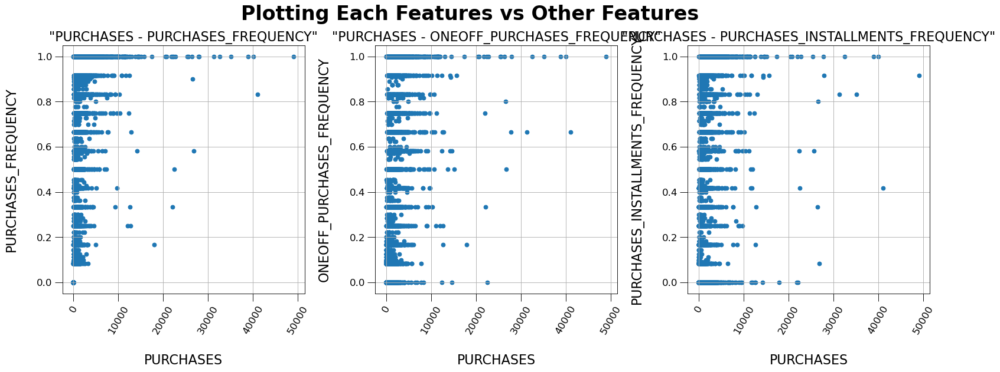

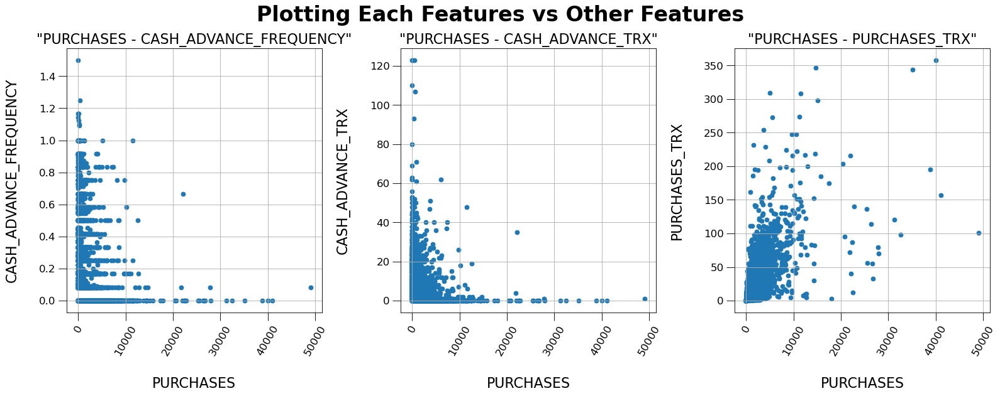

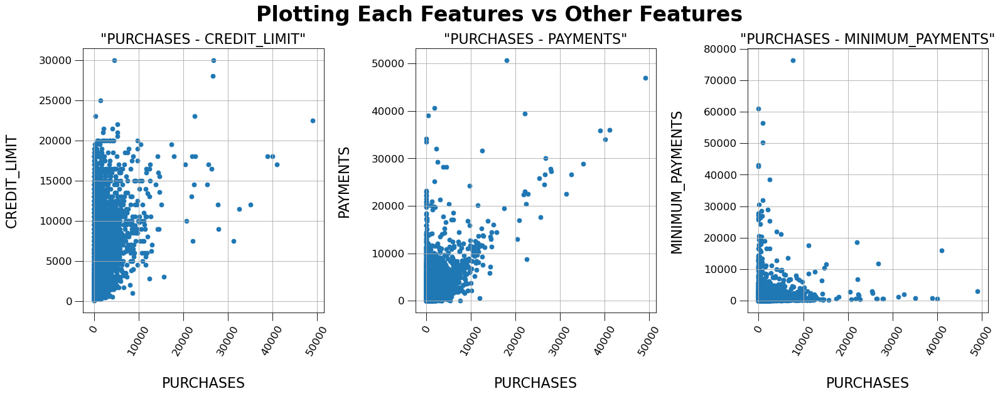

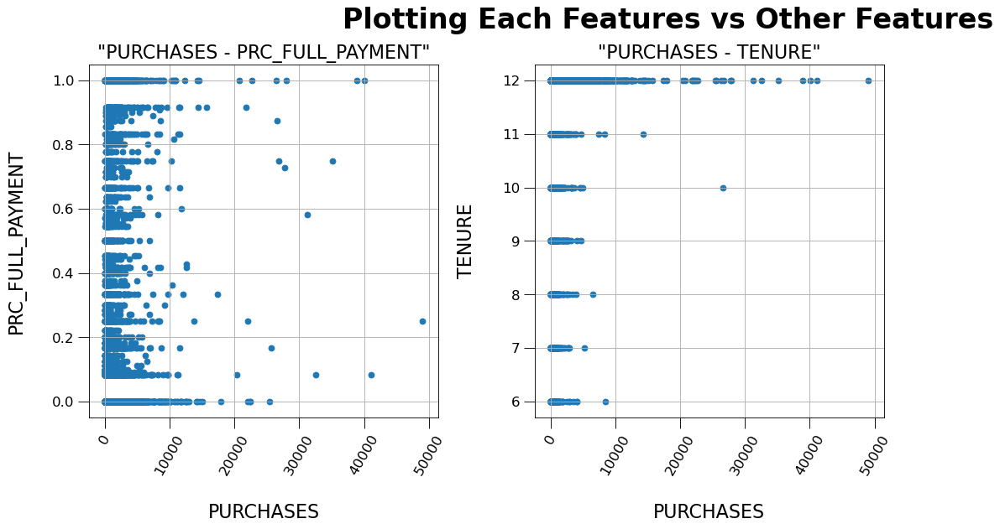


Plotting ONEOFF_PURCHASES with other columns:



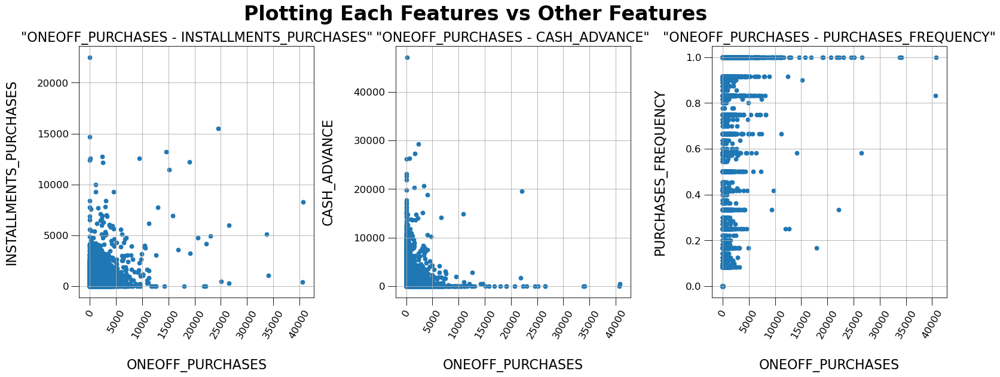

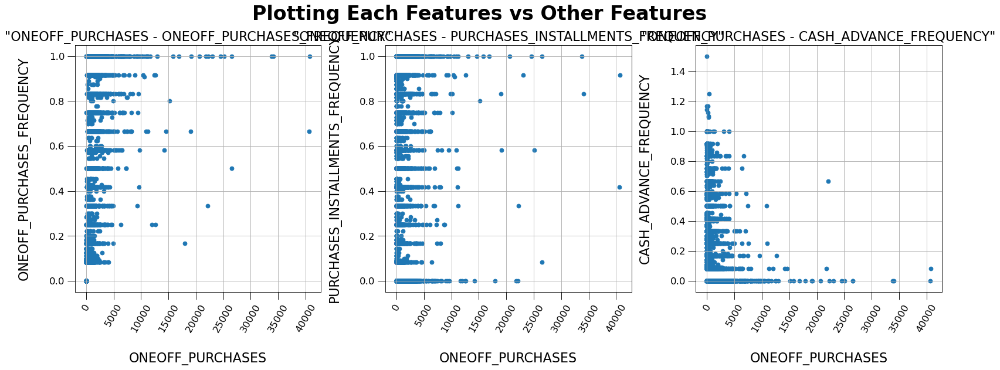

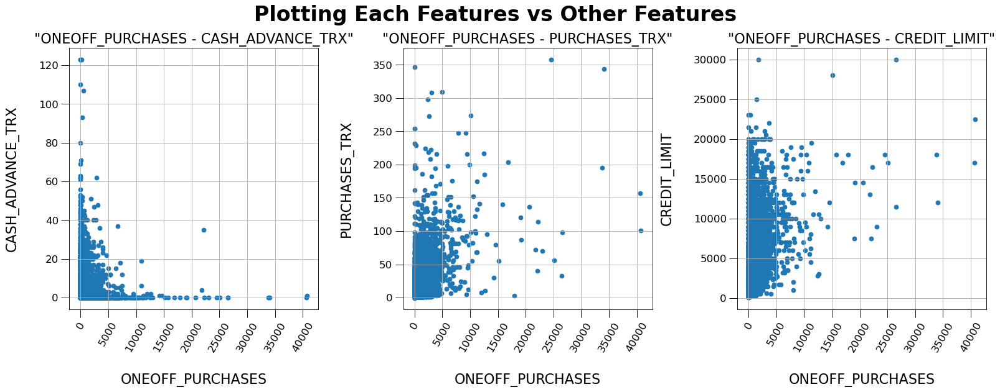

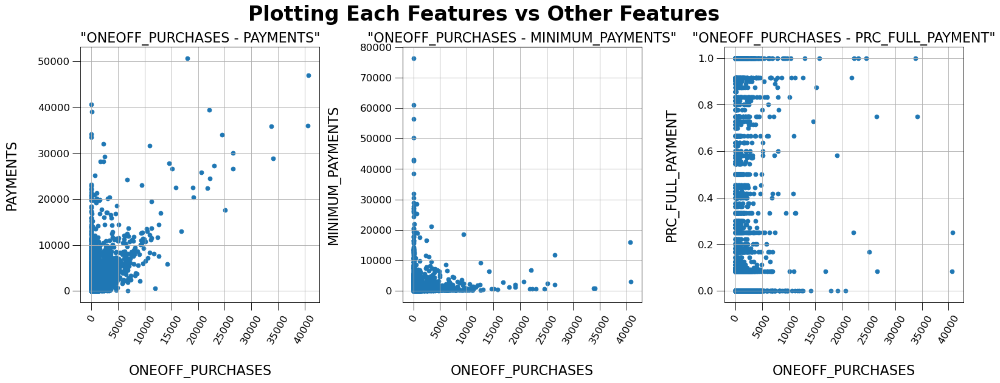

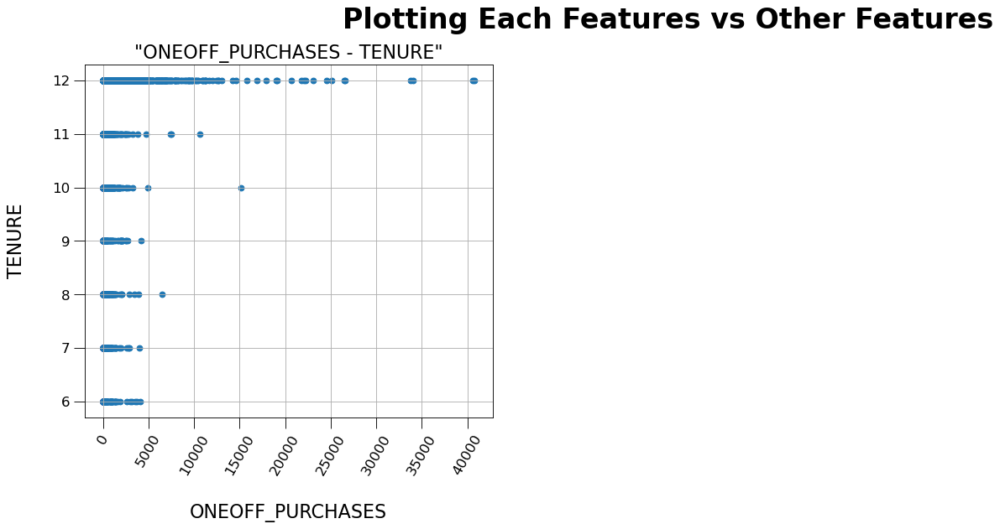


Plotting INSTALLMENTS_PURCHASES with other columns:



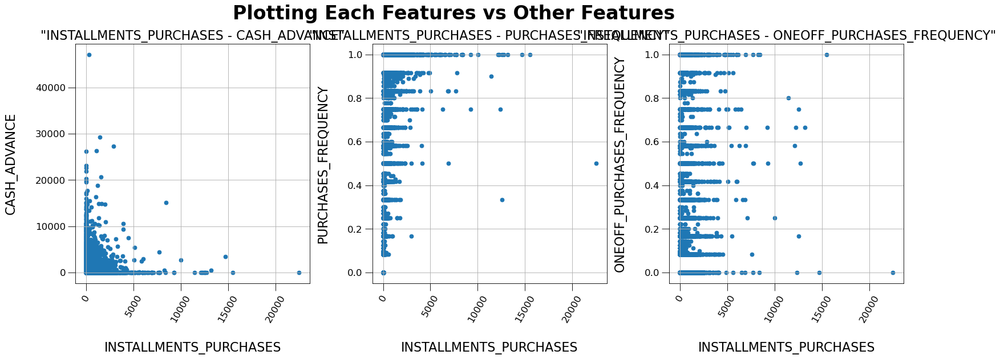

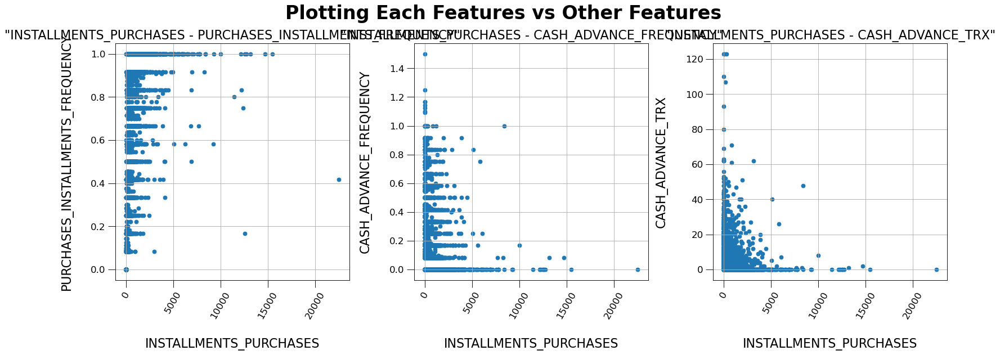

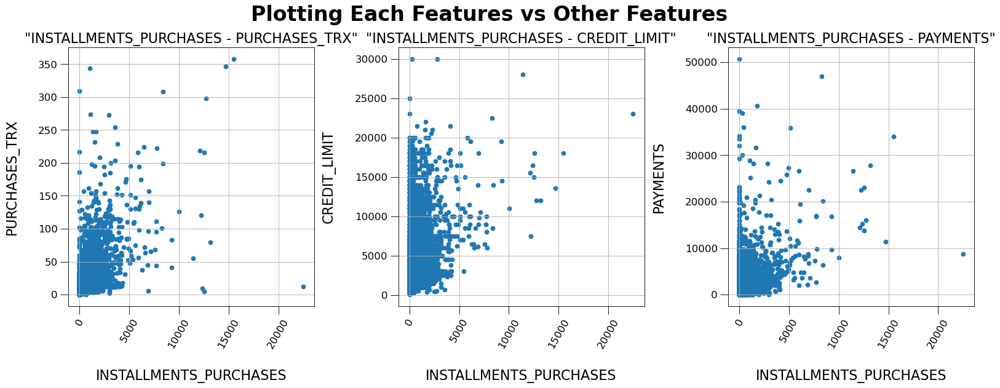

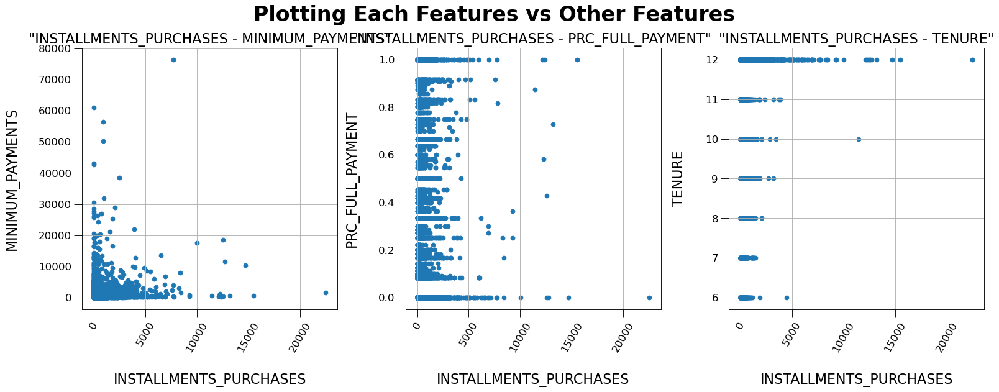


Plotting CASH_ADVANCE with other columns:



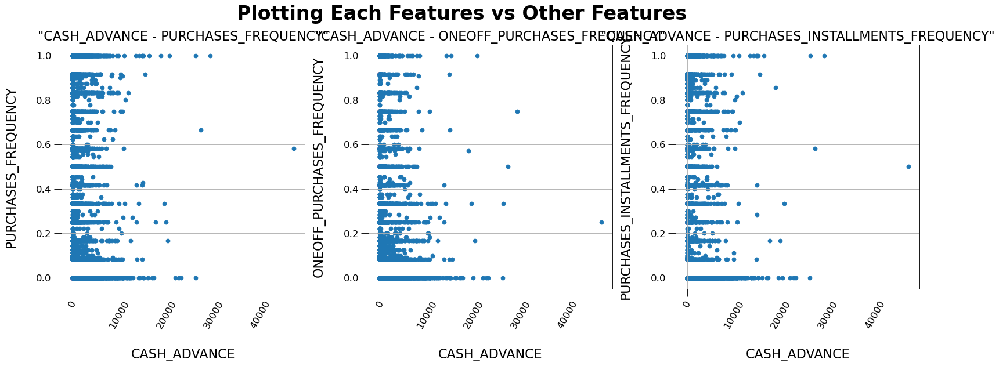

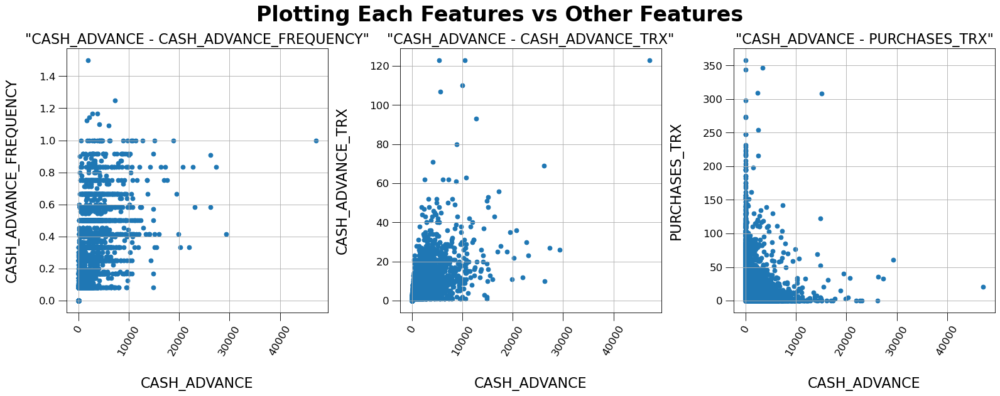

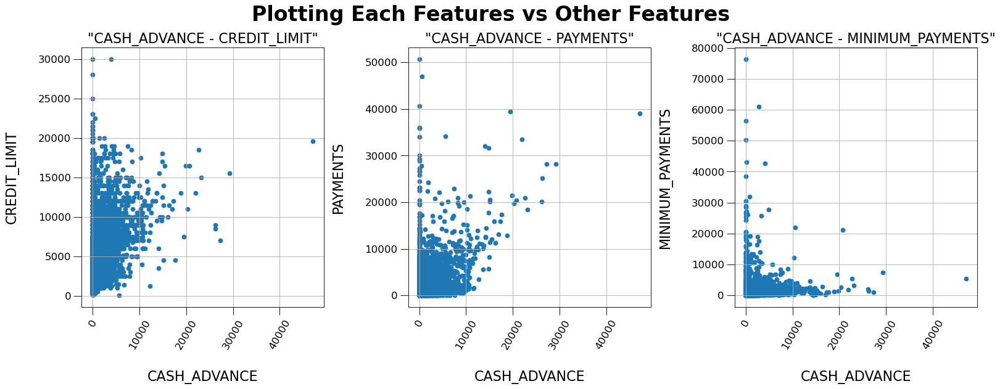

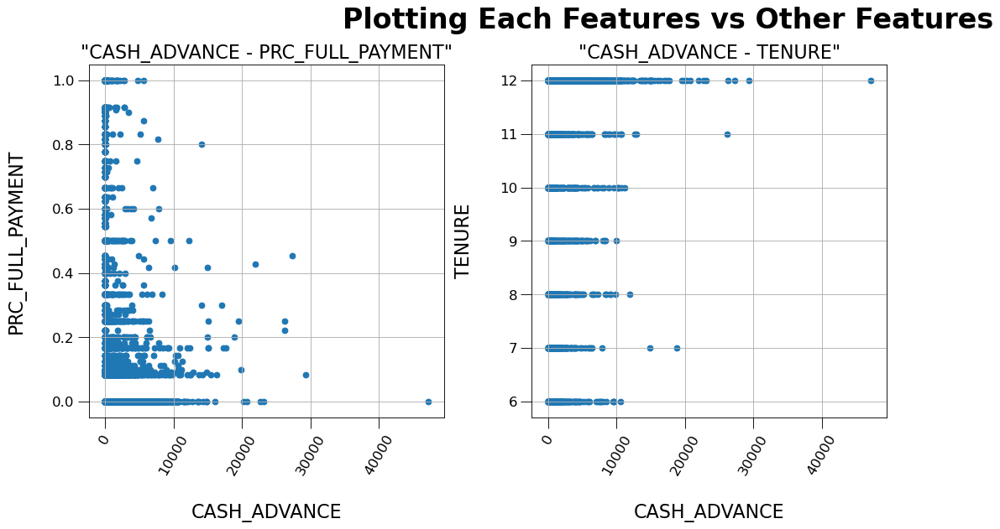


Plotting PURCHASES_FREQUENCY with other columns:



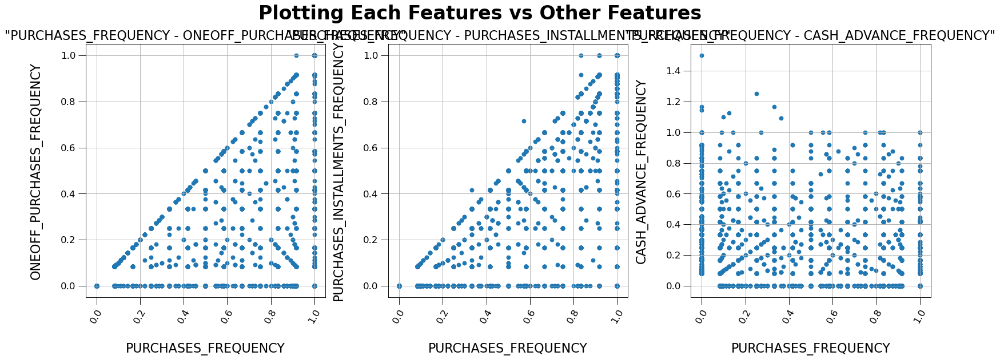

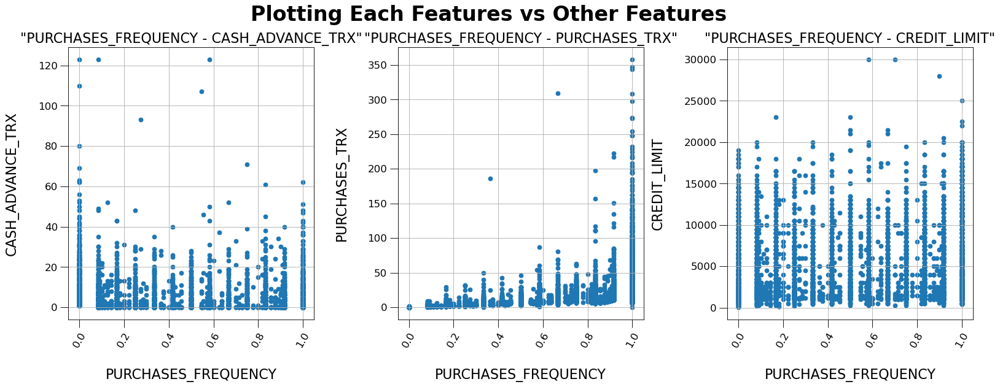

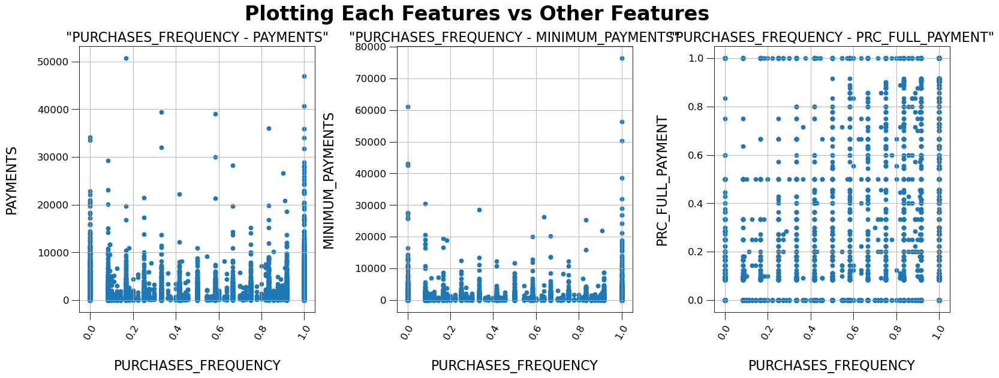

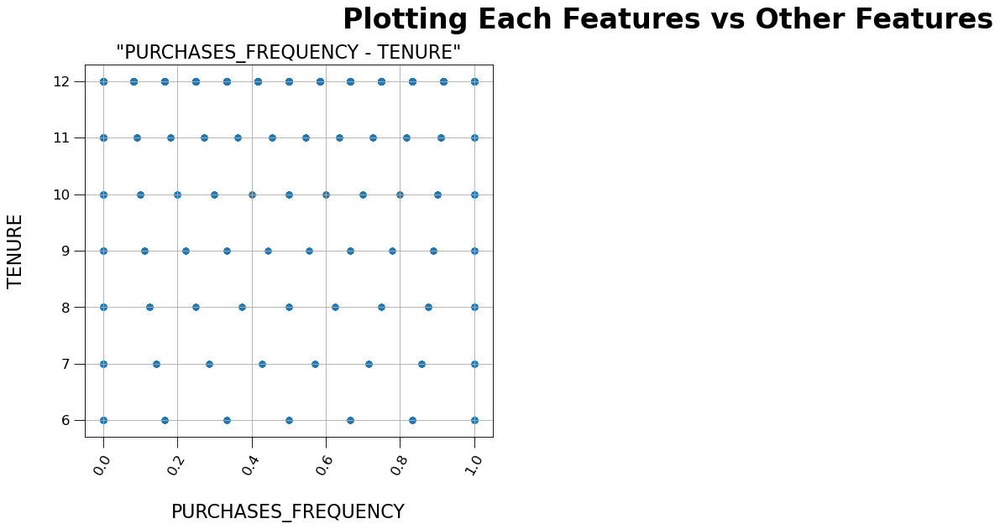


Plotting ONEOFF_PURCHASES_FREQUENCY with other columns:



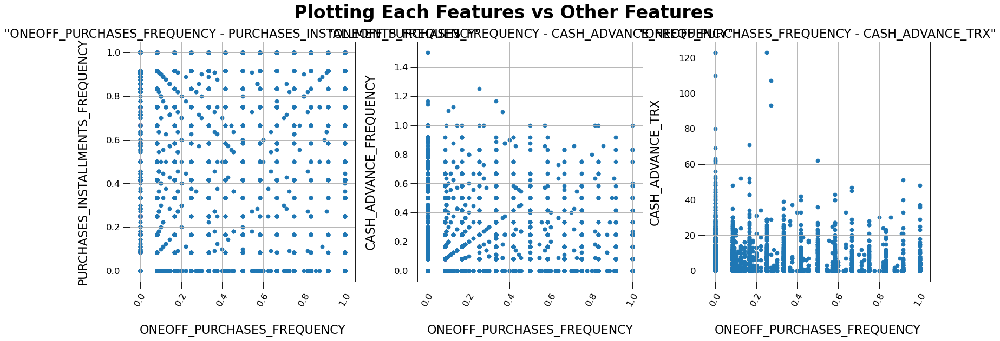

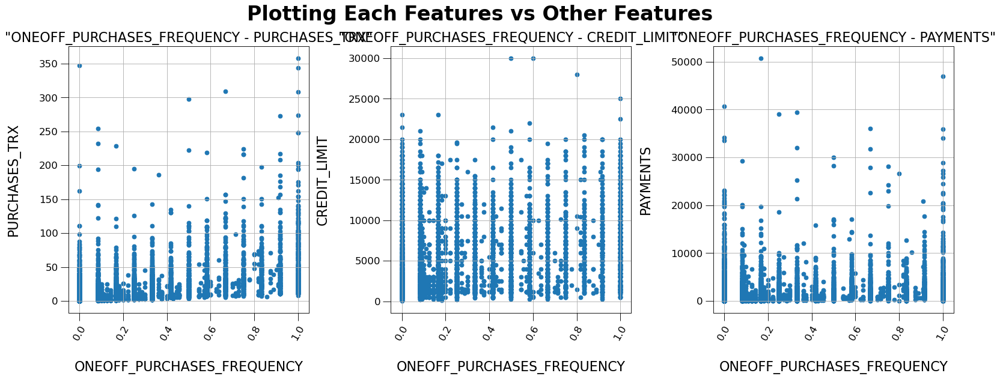

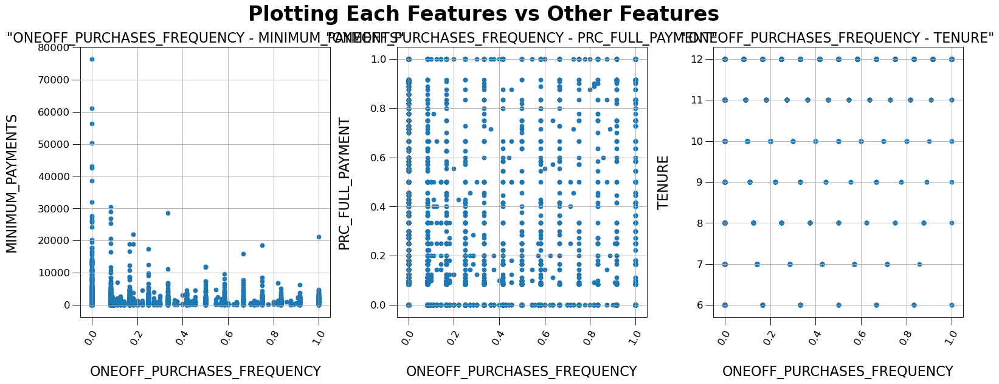


Plotting PURCHASES_INSTALLMENTS_FREQUENCY with other columns:



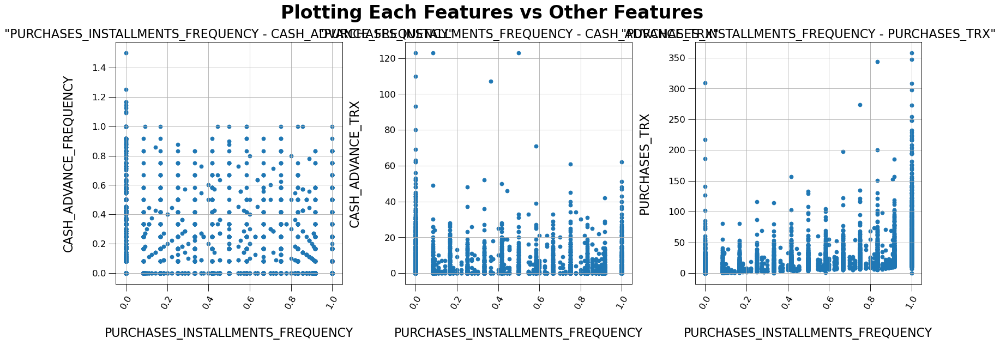

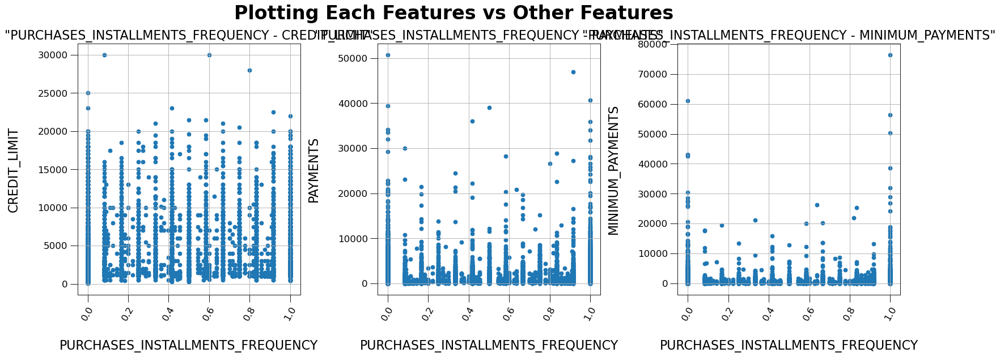

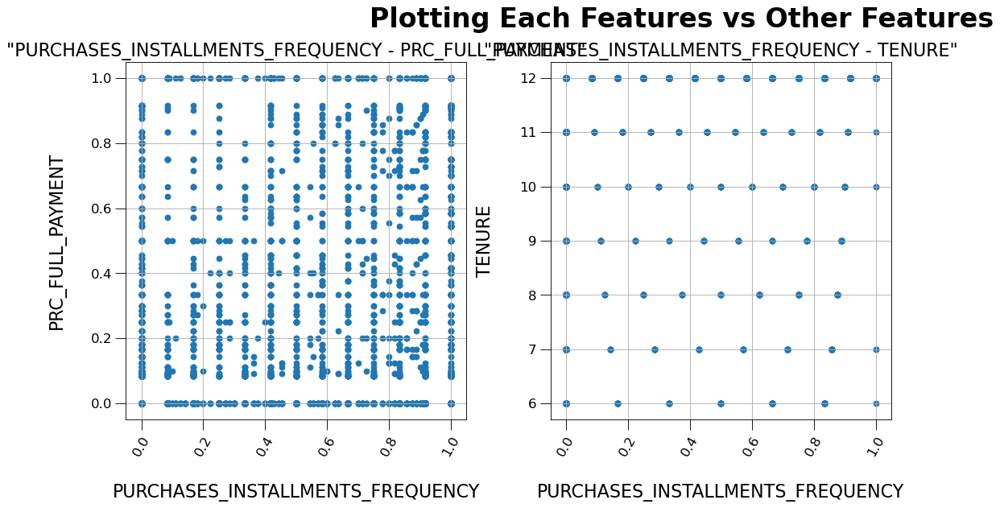


Plotting CASH_ADVANCE_FREQUENCY with other columns:



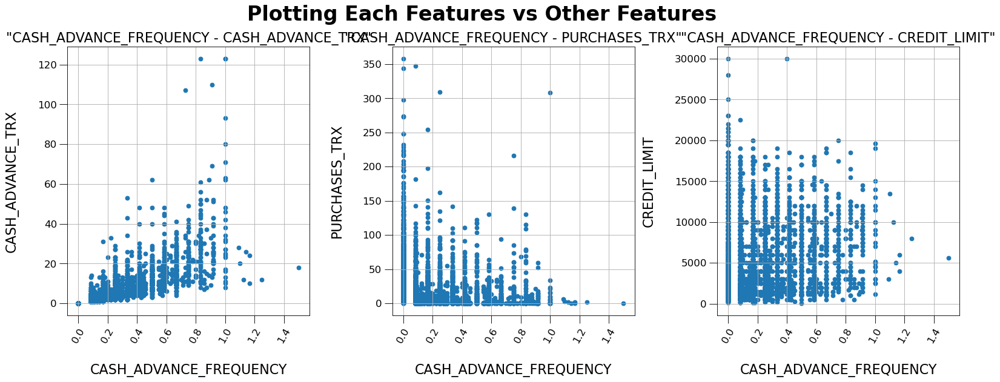

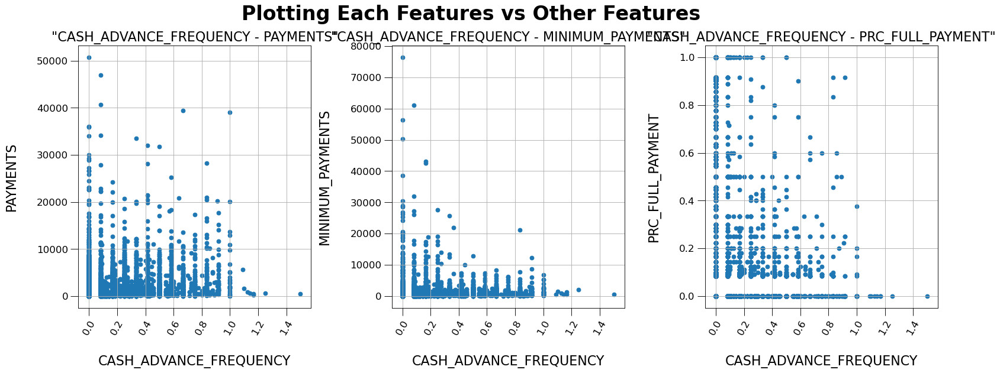

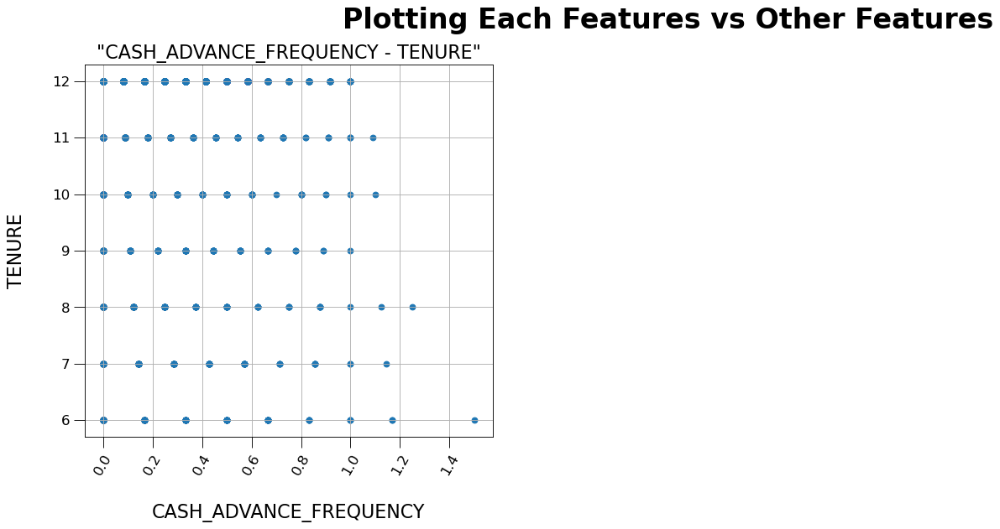


Plotting CASH_ADVANCE_TRX with other columns:



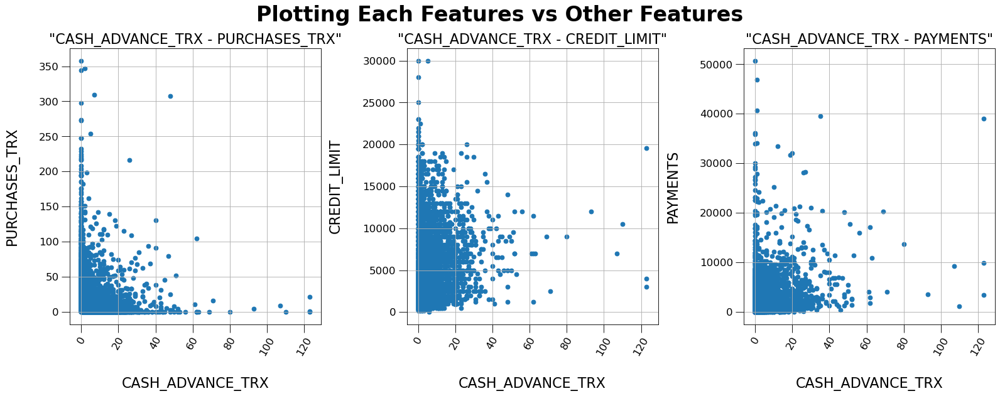

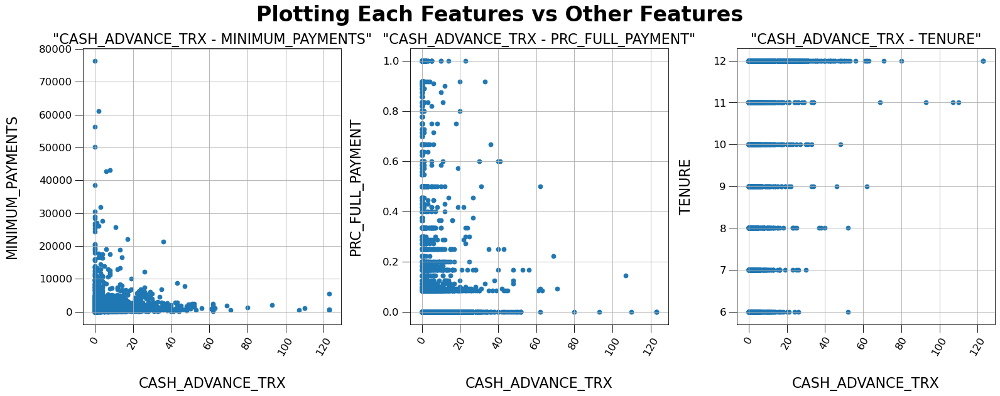


Plotting PURCHASES_TRX with other columns:



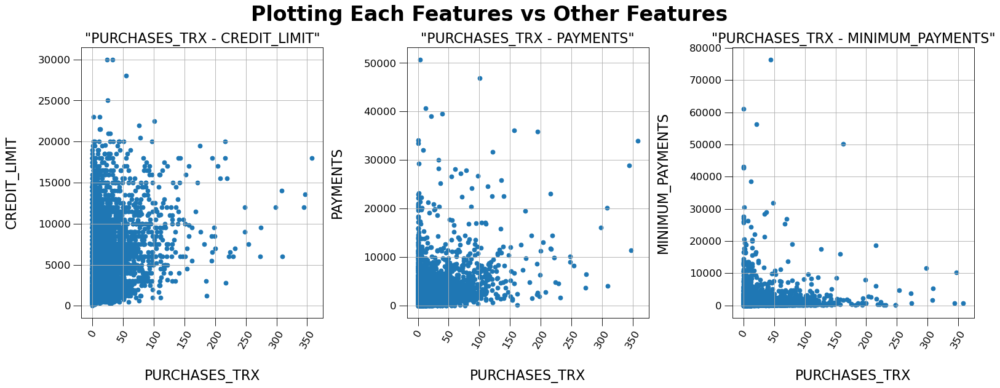

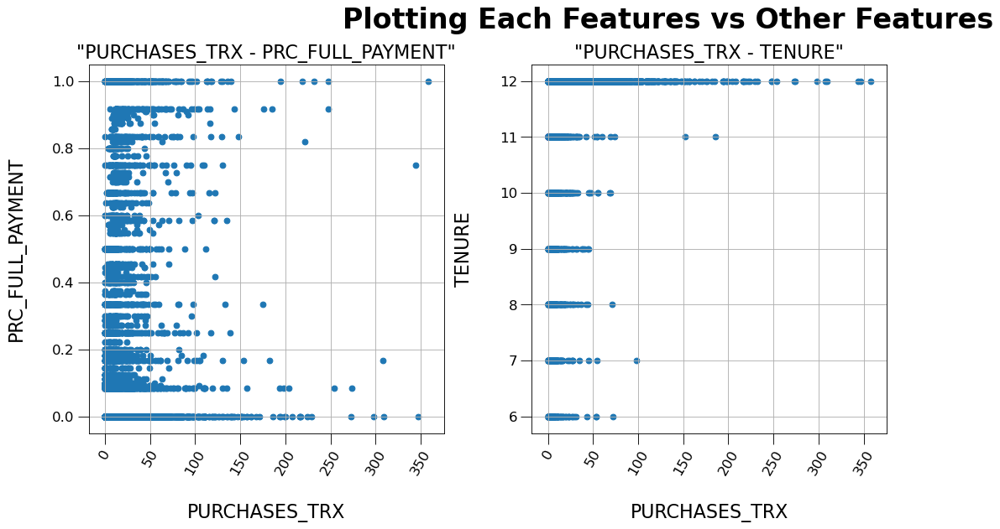


Plotting CREDIT_LIMIT with other columns:



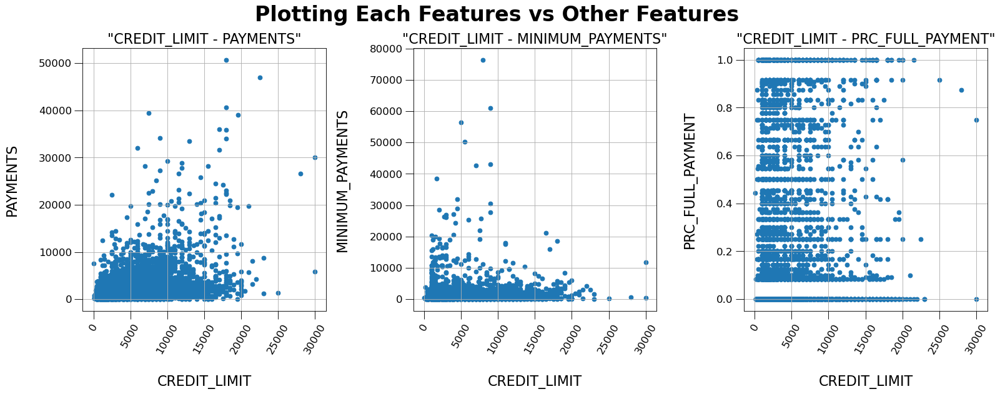

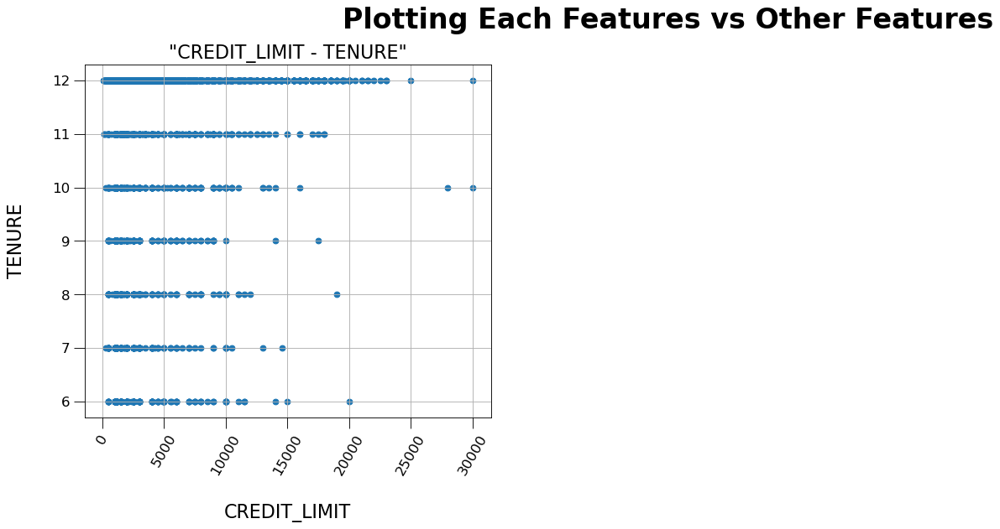


Plotting PAYMENTS with other columns:



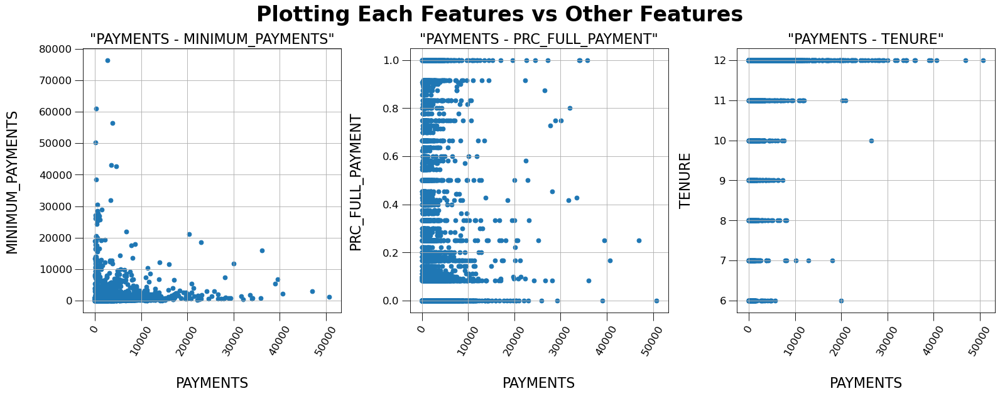


Plotting MINIMUM_PAYMENTS with other columns:



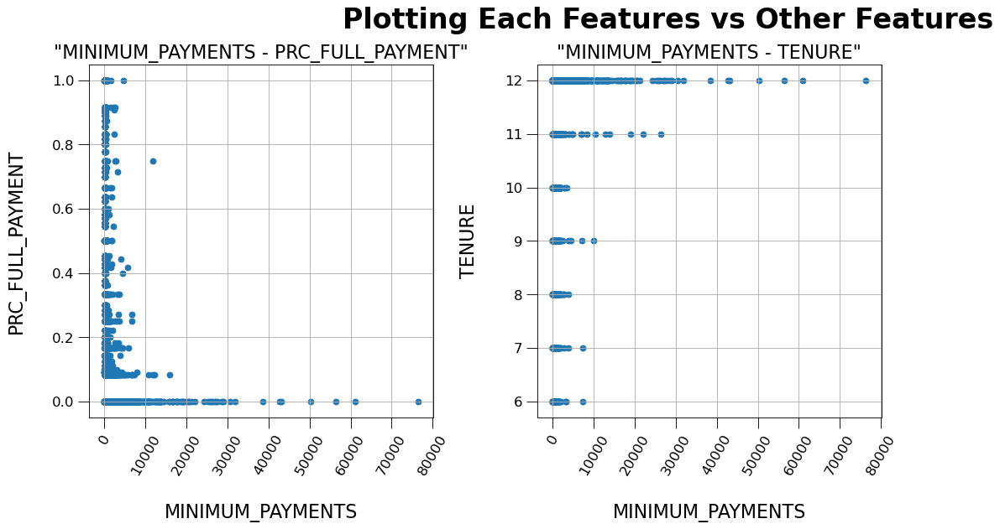


Plotting PRC_FULL_PAYMENT with other columns:



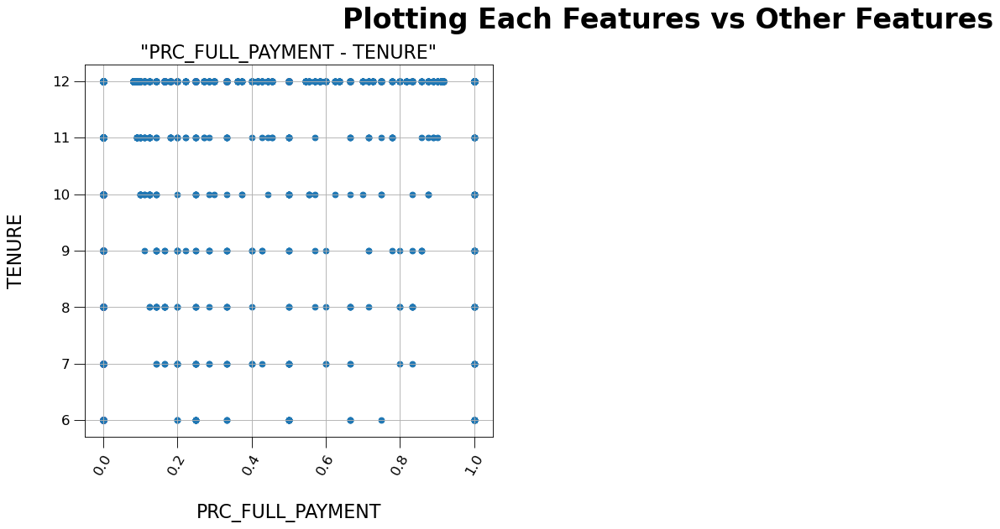


Plotting TENURE with other columns:



In [23]:
scatter_subplots(df)

<div style=" font-size:14px; line_height:160%">
There does not seem to be significant outliers in the dataset based on the plots above.

<div style=" font-size:18px; line_height:160%">
Madeling

<div style=" font-size:14px; line_height:160%">
Since the KMeans method uses the distances between the values, we should scale the values of the dataset.

In [24]:
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df)

In [25]:
scaled_features = pd.DataFrame(scaled_features, columns=df.columns)
scaled_features

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.732324,-0.249676,-0.424866,-0.357093,-0.348958,-0.467043,-0.806039,-0.679242,-0.706724,-0.675746,-0.476231,-0.511065,-0.960538,-0.530484,-0.310825,-0.525620,0.360626
1,0.786949,0.134167,-0.469490,-0.357093,-0.454600,2.603145,-1.221215,-0.679242,-0.916411,0.573109,0.109491,-0.591496,0.688667,0.822842,0.089145,0.234302,0.360626
2,0.447051,0.518011,-0.107833,0.108359,-0.454600,-0.467043,1.269831,2.670774,-0.916411,-0.675746,-0.476231,-0.108912,0.826100,-0.384695,-0.101681,-0.525620,0.360626
3,0.048930,-1.017363,0.231681,0.545312,-0.454600,-0.368981,-1.013628,-0.400075,-0.916411,-0.259462,-0.329801,-0.551280,0.826100,-0.600488,0.000000,-0.525620,0.360626
4,-0.359030,0.518011,-0.462006,-0.347461,-0.454600,-0.467043,-1.013628,-0.400075,-0.916411,-0.675746,-0.476231,-0.551280,-0.905564,-0.365176,-0.265684,-0.525620,0.360626
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8926,-0.738286,0.518011,-0.333316,-0.357093,-0.132226,-0.467043,1.269831,-0.679242,1.180468,-0.675746,-0.476231,-0.350204,-0.960538,-0.487541,-0.349682,1.184206,-4.124053
8927,-0.742760,0.518011,-0.329162,-0.357093,-0.122393,-0.467043,1.269831,-0.679242,1.180468,-0.675746,-0.476231,-0.350204,-0.960538,-0.504793,0.000000,-0.525620,-4.124053
8928,-0.740734,-0.185704,-0.401946,-0.357093,-0.294697,-0.467043,0.854656,-0.679242,0.761094,-0.675746,-0.476231,-0.390419,-0.960538,-0.572296,-0.335304,0.329293,-4.124053
8929,-0.745511,-0.185704,-0.469490,-0.357093,-0.454600,-0.449622,-1.221215,-0.679242,-0.916411,0.156826,-0.183370,-0.591496,-1.097971,-0.582259,-0.346737,0.329293,-4.124053


In [26]:
kmeans_parameters = {"init": "random", "n_init": 50, "max_iter": 300, "random_state": 42}

In [27]:
List_inertia = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_parameters)  # ** open dictionary
    kmeans.fit(scaled_features)
    List_inertia.append(kmeans.inertia_)

In [28]:
# list of the kmeans.inertia_
List_inertia

[151827.00000000006,
 127494.1693273205,
 111732.70267278337,
 98829.86050131654,
 91258.43743580148,
 84618.85110655024,
 79302.74504196637,
 74281.93323911318,
 69650.76134310718,
 66276.69102292569]

<div style=" font-size:14px; line_height:160%">
The parameter inertia can be used to determine the proper number of clusters.<br/>
Look at the plot below:

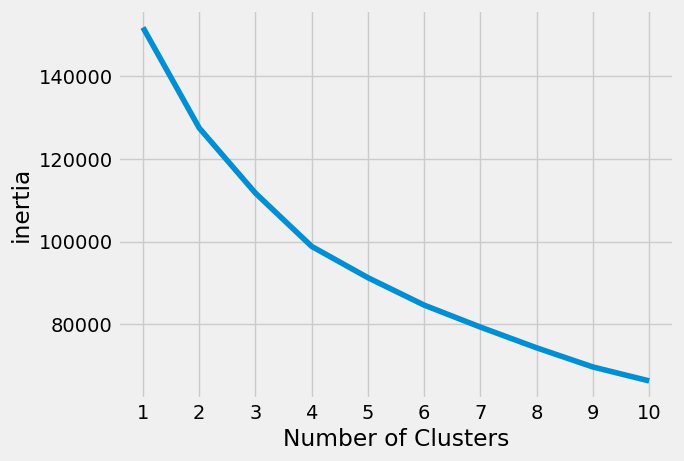

In [29]:
plt.style.use("fivethirtyeight")
plt.plot(range(1, 11), List_inertia)
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("inertia")
plt.show()

<div style=" font-size:14px; line_height:160%">
With KneeLocator we can make sure that we choose a correct number as the number of clusters.

In [30]:
kl = KneeLocator(range(1, 11), List_inertia, curve="convex", direction="decreasing")
kl.elbow

4

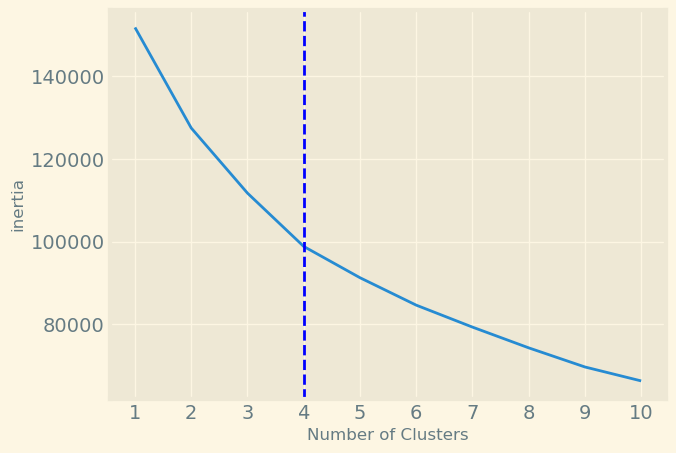

In [31]:
plt.style.use("Solarize_Light2")
plt.plot(range(1, 11), List_inertia)
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("inertia")
plt.axvline(x=kl.elbow, color="b", label="axvline - full height", ls="--")
plt.show()

<div style=" font-size:14px; line_height:160%">
In the following, we use two metrics in order to help us verify our cluster number choosing.

<div style=" font-size:18px; line_height:160%">
Metric #1: Silhouette Coefficients

In [32]:
silhouette_coefficients = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_parameters)
    kmeans.fit(scaled_features)
    score = silhouette_score(scaled_features, kmeans.labels_)
    silhouette_coefficients.append(score)

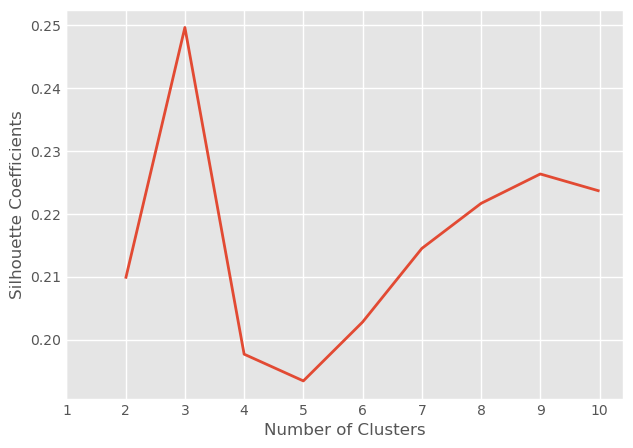

In [33]:
plt.style.use("ggplot")
plt.plot(range(2, 11), silhouette_coefficients )
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficients")
plt.show()

<div style=" font-size:18px; line_height:160%">
Metric #2: Calinski Coefficients

In [34]:
calinski_coefficients = []
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_parameters)
    kmeans.fit(scaled_features)
    score = calinski_harabasz_score(scaled_features, kmeans.labels_)
    calinski_coefficients.append(score)

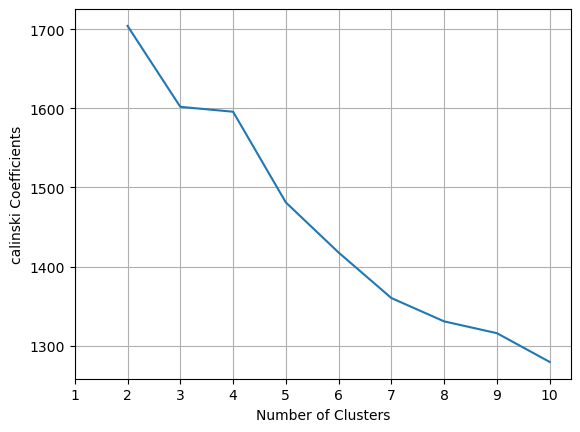

In [35]:
plt.style.use("default")
plt.plot(range(2, 11), calinski_coefficients )
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("calinski Coefficients")
plt.grid()
plt.show()

<div style=" font-size:14px; line_height:160%">
By considering the graph of inertias, silhouette scores and calinski scores, we choose number of clusters equal to 4.

In [36]:
kmeans = KMeans(n_clusters=4, **kmeans_parameters)
kmeans.fit(scaled_features)

KMeans(init='random', n_clusters=4, n_init=50, random_state=42)

In [37]:
kmeans.labels_

array([2, 1, 3, ..., 3, 2, 2])

In [38]:
LABELS = pd.Series(kmeans.labels_, name="LABELS")
LABELS.head(10)

0    2
1    1
2    3
3    2
4    2
5    3
6    0
7    3
8    2
9    2
Name: LABELS, dtype: int32

In [39]:
df1 = pd.concat([df, LABELS], axis=1)

In [40]:
df1

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,LABELS
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,2
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,3
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.430935,0.000000,12,2
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8926,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,3
8927,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,864.430935,0.000000,6,3
8928,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,3
8929,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,2


In [41]:
the_clusters = sorted(df1['LABELS'].unique())
the_clusters

[0, 1, 2, 3]

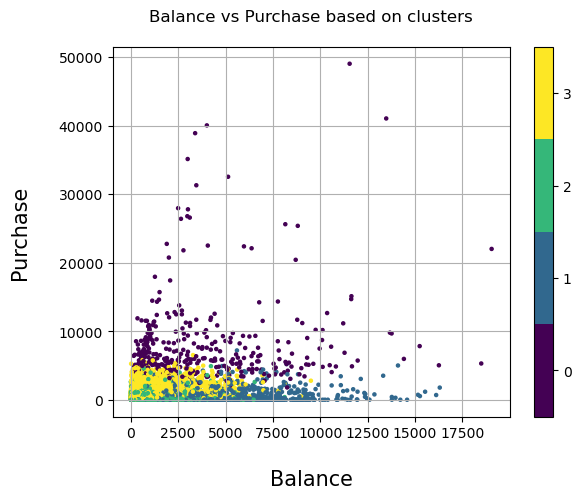

In [42]:
plt.figure()
plot = plt.scatter(df1["BALANCE"], df1["PURCHASES"], 
#                    c=kmeans.labels_, 
                   c=df1["LABELS"], 
                   cmap=mpl.cm.get_cmap('viridis', 4), 
                   s=5, 
                  )
plt.title("Balance vs Purchase based on clusters\n")

plt.xlabel("\nBalance", fontsize=15)
plt.ylabel("Purchase\n", fontsize=15)
plt.grid()

plt.colorbar(spacing="uniform", 
             ticks=df1["LABELS"].unique(), 
            )
plt.clim(-0.5, 3.5)

In [43]:
def plotting(df, x_name, y_name):
    
    colors = mpl.cm.get_cmap('viridis', 4)

    plt.figure(figsize=(10, 10))

    for i in range(len(the_clusters)):

        plt.subplot(2,2,i+1)
        
        plot = plt.scatter(df1[x_name][df1["LABELS"]==i], 
                           df1[y_name][df1["LABELS"]==i], 
                           c=mpl.colors.rgb2hex(colors(i)[:3]),
                           s=5, 
                          )
        
        plt.title(f"Cluster {i+1}\n", fontsize=16)

        plt.xlabel(f"\n{x_name}\n", fontsize=13)
        plt.ylabel(f"{y_name}\n", fontsize=13)
        
        plt.axis([-5, df[x_name].max()+2000, 0, df[y_name].max()+2000])
        plt.grid()
        
        plt.colorbar(spacing="uniform", ticks=df1["LABELS"].unique())
        plt.clim(-0.5, 3.5)        
        
    plt.tight_layout()
    plt.show()

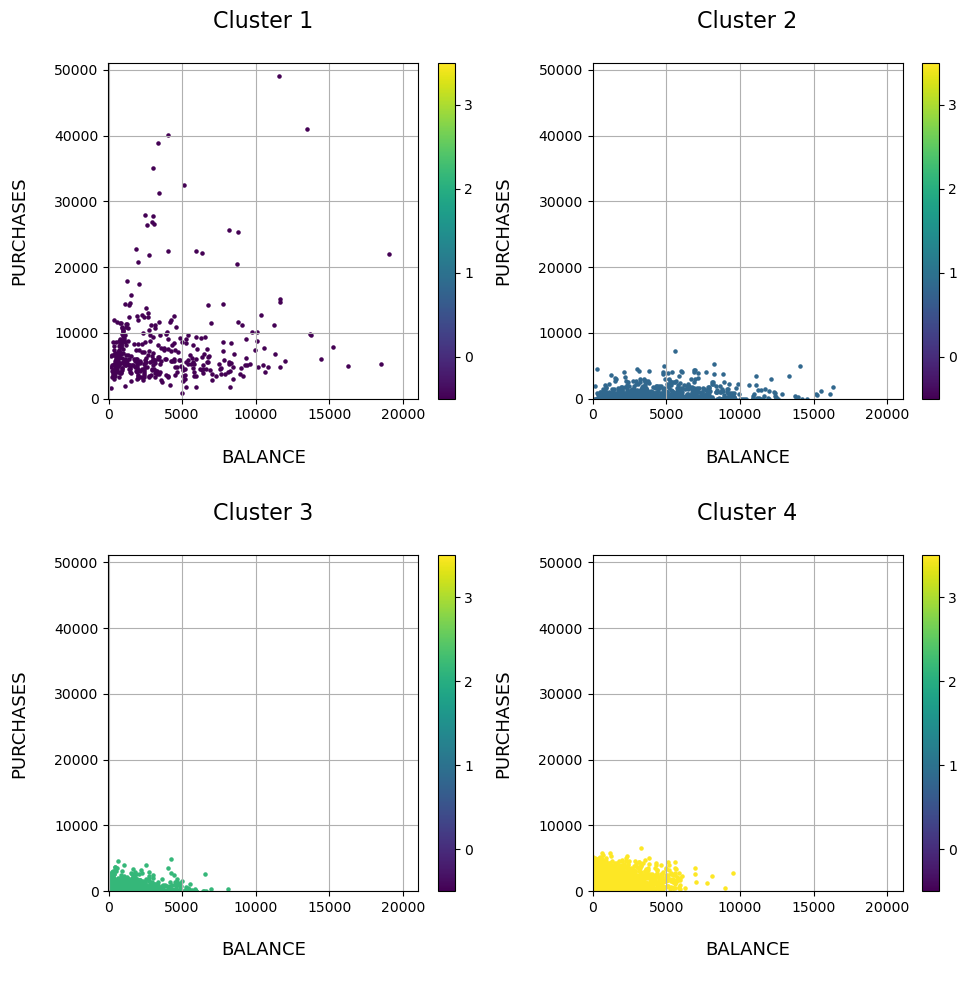

In [44]:
plotting(df1, df1.columns[0], df1.columns[2])

In [45]:
results = df1.groupby("LABELS").mean().reset_index().T
results = results.rename(columns={0: "Class 3", 1: "Class 4",  2: "Class 2", 3: "Class 1"})
results = results.sort_values(by="BALANCE", axis=1)
results

,Class 1,Class 2,Class 3,Class 4
LABELS,3.000000,2.000000,0.000000,1.000000
BALANCE,894.825083,1011.714198,3558.405445,4598.790475
BALANCE_FREQUENCY,0.934788,0.789869,0.986846,0.968389
PURCHASES,1237.819256,269.187665,7686.650025,502.275673
ONEOFF_PURCHASES,595.198735,209.234120,5108.368725,320.572481
INSTALLMENTS_PURCHASES,642.620521,59.953545,2578.281299,181.703191
CASH_ADVANCE,210.582857,596.771499,655.240947,4521.057036
PURCHASES_FREQUENCY,0.885124,0.169851,0.946491,0.287832
ONEOFF_PURCHASES_FREQUENCY,0.297665,0.086246,0.740842,0.138980
PURCHASES_INSTALLMENTS_FREQUENCY,0.711490,0.080320,0.787541,0.185601


<div style=" font-size:18px; line_height:160%">
Conclusions:

<div style=" font-size:16px; line_height:160%">
Let's discuss about the classes shown in the table.

<div style=" font-size:16px; line_height:160%">
Class 1 (Cluster 4 in the plots):<br/>
<br/>
<div style=" font-size:14px; line_height:160%">
Their account balance is the lowest (BALANCE = 894). Their purchase is in the second category (the second buyer). The amount of ONE-OFF purchase and installment purchase is almost equal. Least of all, they take cash from an ATM or bank. Compared to other clusters, they are in the second category of purchase. It means that they are always shopping with their account (card) balance. We said that the amount of their cash and installment purchases is almost the same, but usually they buy more in installments than in cash (in terms of counting). The number of purchase transactions is second among all clusters. The financial level of this group of customers as well as cluster 2 is three times lower than the other two groups because their minimum payment is one third of the other two groups.<br/>
<br/>  
<div style=" font-size:16px; line_height:160%">
Class 2 (Cluster 3 in the plots):<br/>
<br/> 
<div style=" font-size:14px; line_height:160%">
The account balance of this group is slightly more than the previous group. Their one-off purchase is much more than installment purchase. In fact, their installment purchase is very low. That one-off and installment purchases are usually done very rarely, which means that they are not much of a shopper at all. They have about three times more purchases with cash. It can be said that they are not very familiar with technology or that they do not know how to work with a bank card. This group and the previous group have two to two and a half times lower credit limits than the other two groups. This group has the least amount of money to pay for purchase.<br/>
<br/>
<div style=" font-size:16px; line_height:160%">
Class 3 (Cluster 1 in the plots):<br/>
<br/>    
<div style=" font-size:14px; line_height:160%">
This group has a large account balance and therefore a lot of income (they are in the second level). They buy seven times more than group number 1 and twenty eight times more than group 2 (first level)! Their one-off purchase is twice as much as their installment purchase, which is much more than other groups (first level). The amount of cash they take from bank is the same as group 2. They are constantly shopping and their purchase transaction is several dozen times that of other groups. The credit limit from their account is more than others and the reason may be their more transactions. Their minimum payment is three times that of the previous groups. <br/>
<br/>
<div style=" font-size:16px; line_height:160%">
Class 4 (Cluster 2 in the plots):<br/>
<br/>    
<div style=" font-size:14px; line_height:160%">
The account balance of this group is the highest and they always have money in their account, but surprisingly, the amount of their purchases, whether one-off or installments, is very small (one to the last level)! But on the other hand, they take a lot of cash from bank, which they don't like to spend much.<br/>
